In [784]:
import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import sys
sys.executable

'C:\\Users\\leejd\\AppData\\Local\\Microsoft\\WindowsApps\\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\\python.exe'

# Utils
### - Implement

In [785]:
ACTION_UP = 0
ACTION_DOWN = 1
ACTION_LEFT = 2
ACTION_RIGHT = 3
ACTIONS = [ACTION_UP, ACTION_DOWN, ACTION_LEFT, ACTION_RIGHT]
ACTION_SYMBOLS = {ACTION_UP: '↑', ACTION_DOWN: '↓', ACTION_LEFT: '←', ACTION_RIGHT: '→'}

In [786]:
# 장애물을 고려하지 않고 이동 가능한 방향을 반환하는 get_available_actions 함수
def get_available_actions(state, grid_reward):
    actions = []
    x, y = state
    # 상하좌우 이동 가능 여부 확인 (장애물 여부는 체크하지 않음)
    if x > 0:  # 위로 이동 가능
        actions.append(ACTION_UP)
    if x < len(grid_reward) - 1:  # 아래로 이동 가능
        actions.append(ACTION_DOWN)
    if y > 0:  # 왼쪽으로 이동 가능
        actions.append(ACTION_LEFT)
    if y < len(grid_reward[0]) - 1:  # 오른쪽으로 이동 가능
        actions.append(ACTION_RIGHT)
    return actions

# 장애물 여부를 확인하지 않고 이동 결과를 반환하는 get_transition 함수
def get_transition(state, action, grid_reward):
    x, y = state
    next_state = state  # 기본적으로 현재 상태 유지
    
    # 가능한 방향으로 이동하거나, 불가능할 경우 현재 상태 유지
    if action == ACTION_UP:
        next_state = (x - 1, y) if x > 0 else state
    elif action == ACTION_DOWN:
        next_state = (x + 1, y) if x < grid_reward.shape[0] - 1 else state
    elif action == ACTION_LEFT:
        next_state = (x, y - 1) if y > 0 else state
    elif action == ACTION_RIGHT:
        next_state = (x, y + 1) if y < grid_reward.shape[1] - 1 else state

    reward = grid_reward[next_state[0], next_state[1]]
    return next_state, reward

# Utils
### - Given

In [787]:
def generate_grid_world(obstacles):
    grid_size = 7
    grid_reward = np.full((grid_size, grid_size), -1)

    for (x, y) in obstacles:
        grid_reward[x, y] = -100

    # Define start and end positions
    start = (0, 0)
    end = (6, 6)
    grid_reward[end[0], end[1]] = 0

    return grid_reward, start, end



def print_policy(policy,end):
    grid_size = policy.shape[0]
    policy_symbols = np.full((grid_size, grid_size), ' ')
    for x in range(grid_size):
        for y in range(grid_size):
            if (x, y) == (end[0], end[1]):
                policy_symbols[x, y] = 'G'  # Goal
            else:
                policy_symbols[x, y] = ACTION_SYMBOLS.get(policy[x, y], ' ')
    for row in policy_symbols:
        print(' '.join(row))

def visualize_map(data, title):
    plt.imshow(data, cmap='gray', interpolation='nearest')
    plt.colorbar(label='Value')
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            plt.text(j, i, f"{data[i, j]:.1f}", ha="center", va="center", color="Green")
    plt.title(title)
    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.show()


def visualize_policy(policy, start, end, title, israndom):
    grid_size = policy.shape[0]
    policy_symbols = np.full((grid_size, grid_size), ' ', dtype="U10")  # 기본 공백으로 초기화

    for x in range(grid_size):
        for y in range(grid_size):
            if (x, y) == (end[0], end[1]):
                policy_symbols[x, y] = 'G'  # Goal
            elif (x, y) == (start[0], start[1]):
                policy_symbols[x, y] = 'S'  # Start
            elif policy[x, y] is None:
                continue  # 장애물 위치는 표시 없음
            else:
                if isinstance(policy[x, y], list):  # 여러 방향인 경우
                    temp_policy_symbol = ''.join(ACTION_SYMBOLS[action] for action in policy[x, y])
                    policy_symbols[x, y] = temp_policy_symbol
                else:
                    policy_symbols[x, y] = ACTION_SYMBOLS.get(policy[x, y], ' ')  # 단일 방향
    
    fig, ax = plt.subplots(figsize=(5, 5))
    ax.set_xlim(0, grid_size)
    ax.set_ylim(0, grid_size)
    ax.set_xticks(np.arange(0, grid_size + 1, 1))
    ax.set_yticks(np.arange(0, grid_size + 1, 1))
    ax.set_yticklabels(np.arange(grid_size, -1, -1))
    ax.grid(True)

    for x in range(grid_size):
        for y in range(grid_size):
            ax.text(y + 0.5, grid_size - x - 0.5, policy_symbols[x, y],
                    ha='center', va='center', fontsize=10 if not israndom else 20)
            if grid[x, y] == -100:  # 장애물 처리
                rect = plt.Rectangle((y, grid_size - x - 1), 1, 1, facecolor='black')
                ax.add_patch(rect)
            elif (x, y) == (end[0], end[1]):  # 목표 지점 처리
                rect = plt.Rectangle((y, grid_size - x - 1), 1, 1, facecolor='green', alpha=0.3)
                ax.add_patch(rect)
            elif (x, y) == (start[0], start[1]):  # 시작 지점 처리
                rect = plt.Rectangle((y, grid_size - x - 1), 1, 1, facecolor='blue', alpha=0.3)
                ax.add_patch(rect)

    plt.title(title)
    plt.show()

# Policy initialization
### - Implement

In [788]:
# 수정된 policy_generator 함수
def policy_generator(grid_reward, israndom, isall=False):
    grid_size = grid_reward.shape[0]
    policy = np.empty((grid_size, grid_size), dtype=object)
    
    for x in range(grid_size):
        for y in range(grid_size):
            if israndom:
                policy[x, y] = np.random.choice(get_available_actions((x, y), grid_reward))  # 무작위 정책
            else:
                policy[x, y] = get_available_actions((x, y), grid_reward)  # 가능한 모든 방향을 포함
    return policy

# Policy evaluation
### - Implement

In [789]:
def policy_evaluation(grid_reward, policy, discount_factor=0.9, theta=1e-1, israndom=True):
    V = grid_reward.copy()
    grid_size = grid_reward.shape[0]
    end = (6, 6)
    max_iterations = 300  # 최대 반복 횟수를 내부에서 설정

    for iteration in range(max_iterations):  # 200번 반복
        delta = 0
        new_V = V.copy()
        
        for x in range(grid_size):
            for y in range(grid_size):
                state = (x, y)
                
                if state == end:
                    new_V[state] = grid_reward[state]
                    continue

                v = 0

                if israndom:
                    valid_actions = []
                    for action in ACTIONS:
                        next_state, reward = get_transition(state, action, grid_reward)
                        v += ((1 / 4) * (reward + discount_factor * V[next_state[0], next_state[1]]))
                else:
                    action = policy[state]
                    next_state, reward = get_transition(state, action, grid_reward)
                    v = reward + discount_factor * V[next_state[0], next_state[1]]

                delta = max(delta, abs(v - V[state]))
                new_V[state] = v

        V = new_V.copy()
        yield V

        if delta < theta:
            break  # 수렴을 빨리 할 경우 종료
        
    print("Policy evaluation completed after 200 iterations.")

# Policy improvement
### - Implement

In [790]:
def policy_improvement(grid_reward, V, discount_factor=0.9):
    grid_size = grid_reward.shape[0]
    new_policy = np.empty((grid_size, grid_size), dtype=object)

    for x in range(grid_size):
        for y in range(grid_size):
            # 목표 지점에서는 정책이 필요하지 않음
            if (x, y) == (6, 6):
                new_policy[x, y] = None
                continue
            
            best_action = None
            best_value = -float('inf')
            available_actions = get_available_actions((x, y), grid_reward)
            
            for action in available_actions:
                next_state, reward = get_transition((x, y), action, grid_reward)
                action_value = reward + discount_factor * V[next_state[0], next_state[1]]
                if action_value > best_value:
                    best_value = action_value
                    best_action = action

            new_policy[x, y] = best_action  # 최적 행동 저장

    return new_policy

# Value iteration
### - Implement

In [791]:
def value_iteration(grid_reward, discount_factor=0.9, theta=1e-1):

    return V, policy

# Initialization
### -Given

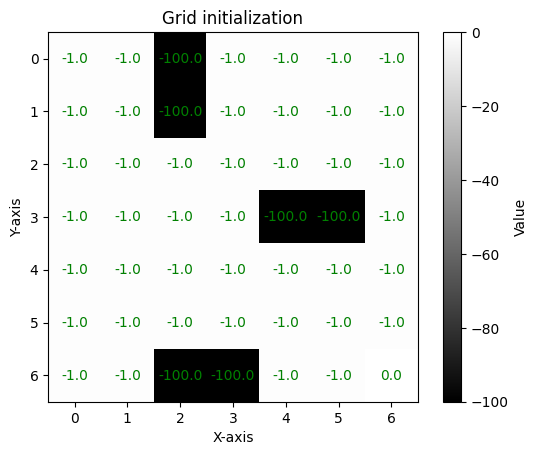

In [792]:
ACTION_UP = 0
ACTION_DOWN = 1
ACTION_LEFT = 2
ACTION_RIGHT = 3
ACTIONS = [ACTION_UP, ACTION_DOWN, ACTION_LEFT, ACTION_RIGHT]
ACTION_SYMBOLS = {ACTION_UP: '↑', ACTION_DOWN: '↓', ACTION_LEFT: '←', ACTION_RIGHT: '→'}

border = f"\n{'='*60}\n"
obstacles = [(0, 2), (1, 2), (3, 4), (3, 5), (6, 2), (6, 3)]
grid, start, end = generate_grid_world(obstacles)
print(border)
visualize_map(grid, "Grid initialization")
print(border)

# Show results
### - Random policy initialization
### - Given

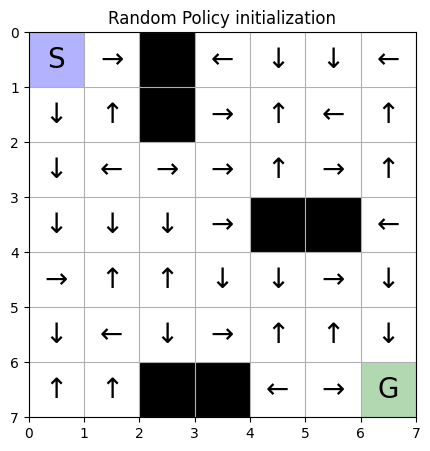

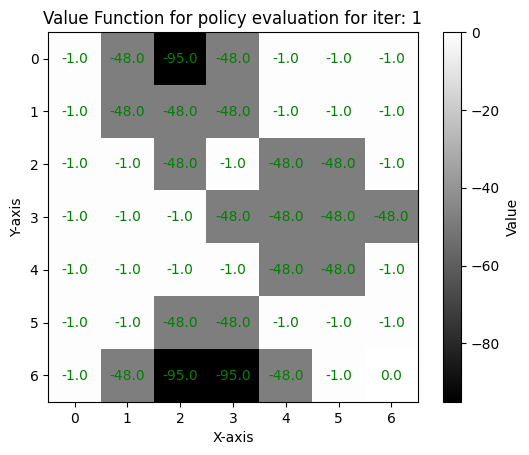

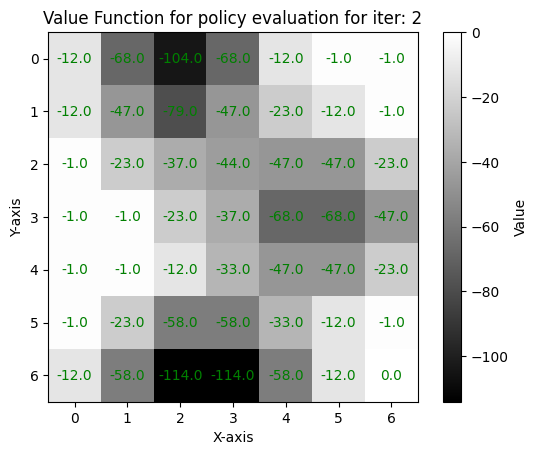

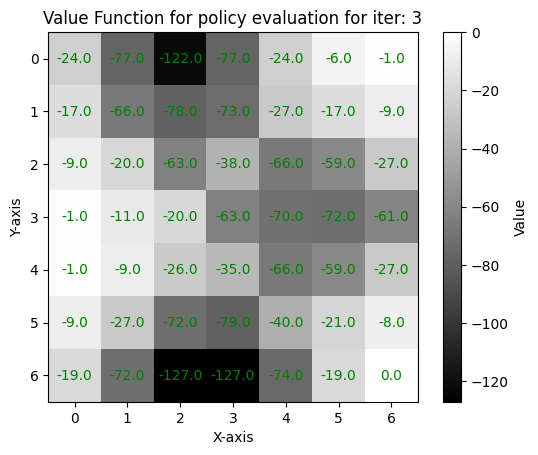

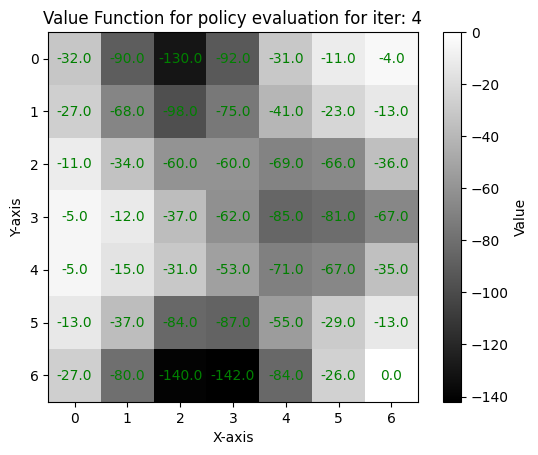

...

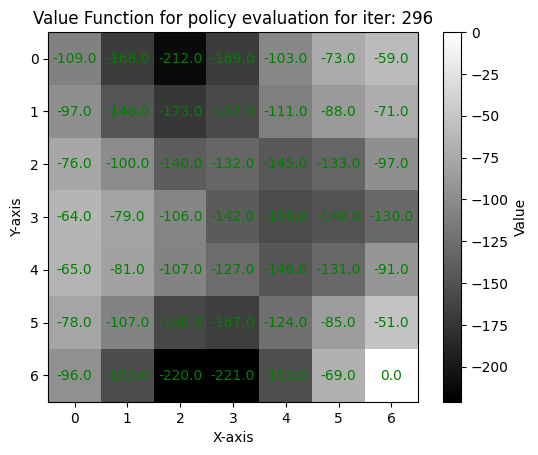

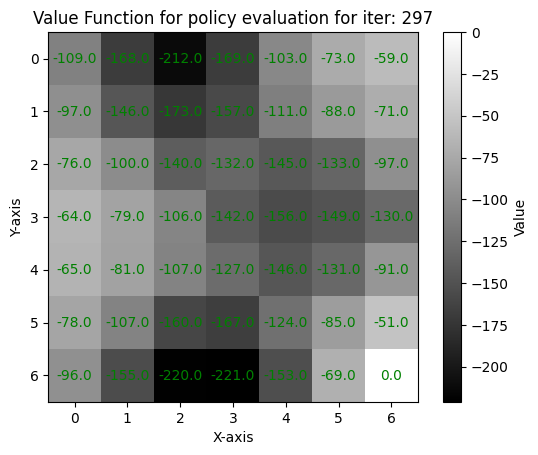

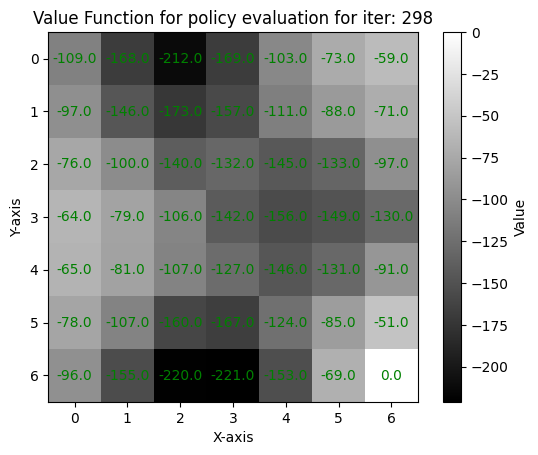

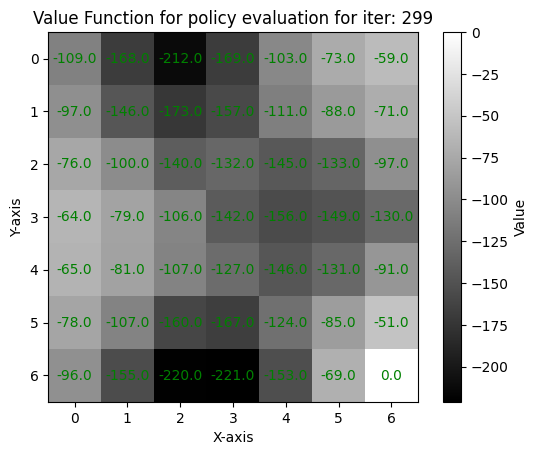

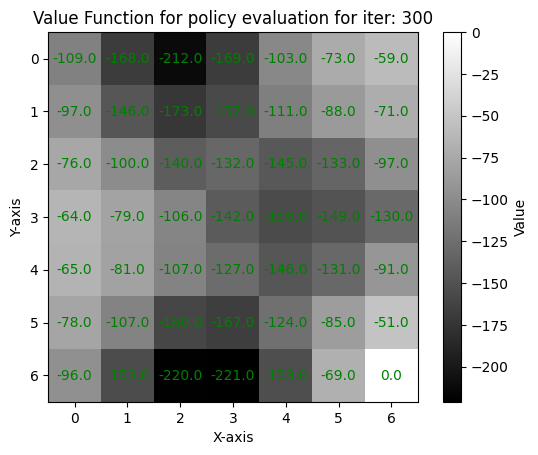



Policy evaluation completed after 200 iterations.


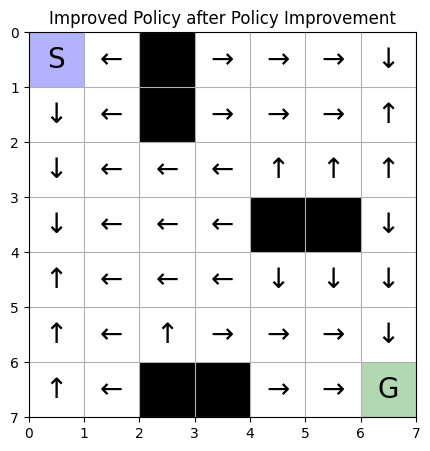

In [793]:
# Policy initialization
random_policy = policy_generator(grid, israndom=True)
visualize_policy(random_policy, start, end, "Random Policy initialization", True)

# Policy evaluation
print(border)
idx = 0
for V_random in policy_evaluation(grid, random_policy, israndom=True):
    idx += 1
    visualize_map(V_random, f"Value Function for policy evaluation for iter: {idx}")
    print(border)

# Policy improvement
improved_policy = policy_improvement(grid, V_random)
visualize_policy(improved_policy, start, end, "Improved Policy after Policy Improvement", True)

# Show results
### - All possible direction policy initialization
### - Given

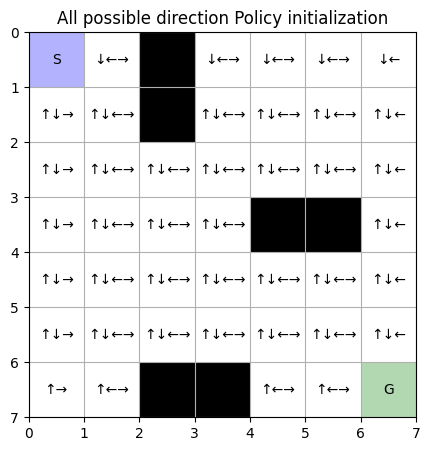

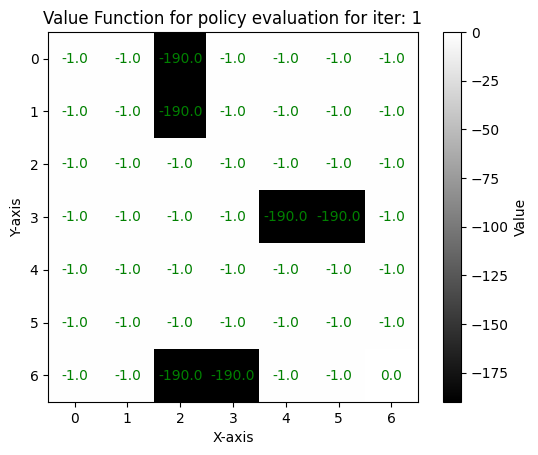

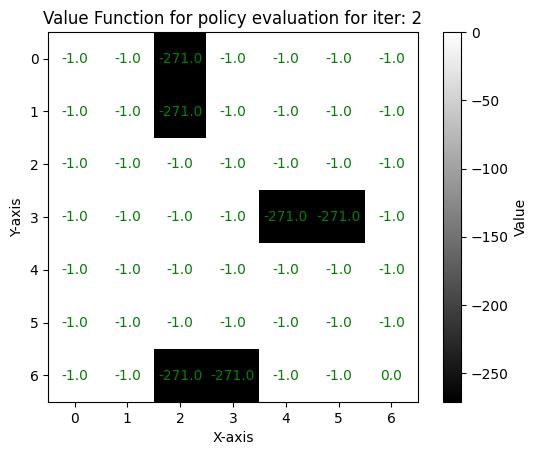

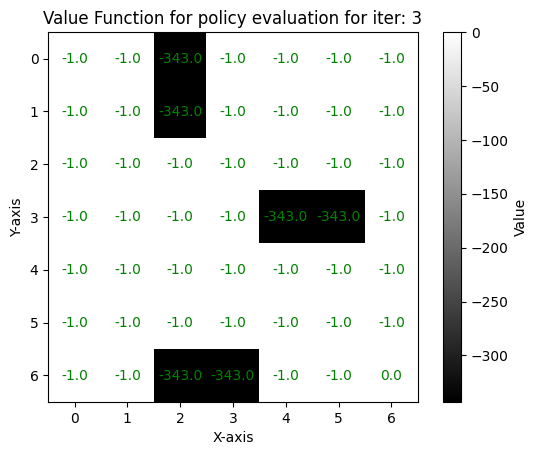

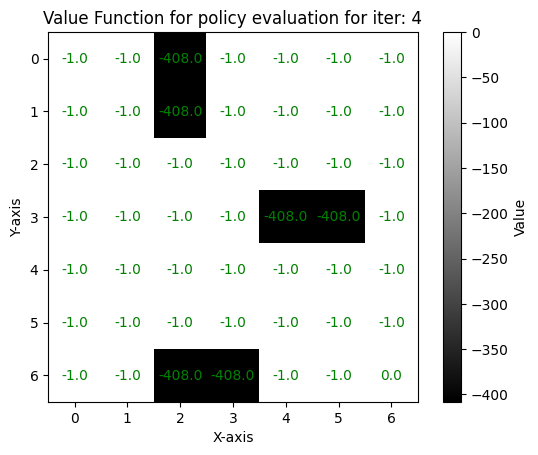

...

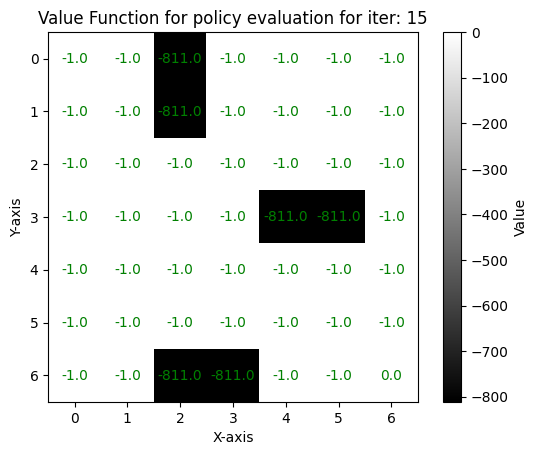

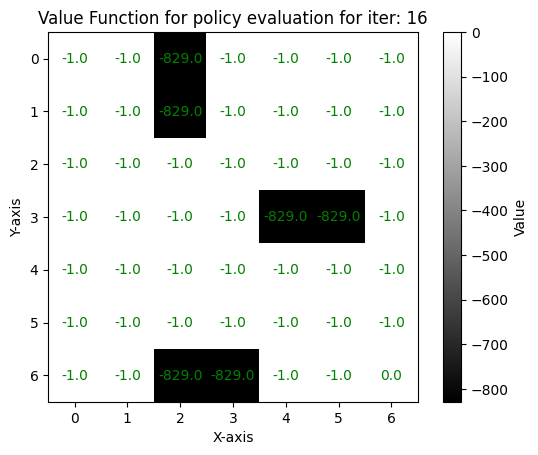

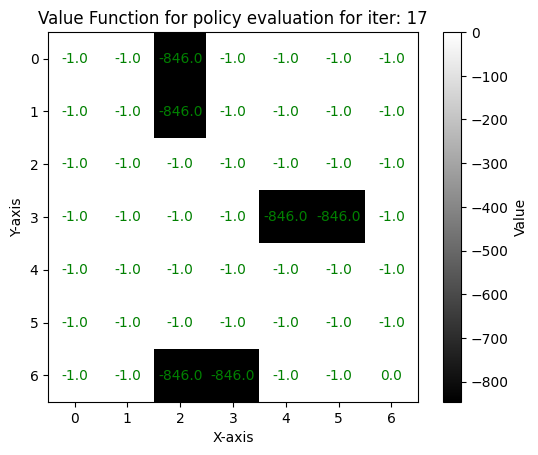

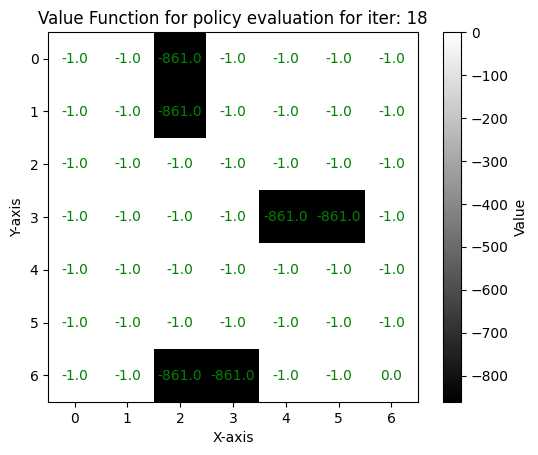

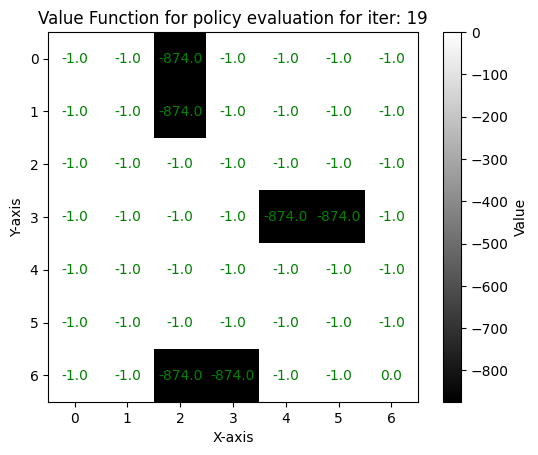

KeyboardInterrupt: 

In [794]:
# Policy initialization
allpossibledirection_policy = policy_generator(grid, israndom=False)
visualize_policy(allpossibledirection_policy, start, end, "All possible direction Policy initialization", False)

# Policy evaluation

print(border)
idx = 0
for V_random in policy_evaluation(grid, allpossibledirection_policy, discount_factor=0.9, israndom=False):
    idx += 1
    visualize_map(V_random, f"Value Function for policy evaluation for iter: {idx}")
    print(border)

# Policy improvement
allpossibledirection_improved_policy = policy_improvement(grid, V_random)
visualize_policy(allpossibledirection_improved_policy, start, end, "Improved Policy after Policy Improvement", False)




# Show results
### - Value iteration
### - Given

In [ ]:
V_opt, optimal_policy = value_iteration(grid)
visualize_map(V_opt, "Optimal Value Function from Value Iteration")

visualize_policy(optimal_policy, start, end, "Optimal Policy from Value Iteration", True)

NameError: name 'policy' is not defined